In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import datetime as dt
from typing import Tuple

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.offline


# read data
in_kaggle = False


def get_data_file_path(is_in_kaggle: bool) -> Tuple[str, str, str]:
    train_path = ''
    test_path = ''
    sample_submission_path = ''

    if is_in_kaggle:
        # running in Kaggle, inside the competition
        train_path = '../input/tabular-playground-series-jan-2021/train.csv'
        test_path = '../input/tabular-playground-series-jan-2021/test.csv'
        sample_submission_path = '../input/tabular-playground-series-jan-2021/sample_submission.csv'
    else:
        # running locally
        train_path = 'data/train.csv'
        test_path = 'data/test.csv'
        sample_submission_path = 'data/sample_submission.csv'

    return train_path, test_path, sample_submission_path

C:\ProgramData\Anaconda3\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
C:\ProgramData\Anaconda3\lib\site-packages\numpy\.libs\libopenblas.IPBC74C7KURV7CB2PKT5Z5FNR3SIBV4J.gfortran-win_amd64.dll
C:\ProgramData\Anaconda3\lib\site-packages\numpy\.libs\libopenblas.PYQHXLVVQ7VESDPUVUADXEVJOBGHJPAY.gfortran-win_amd64.dll
  stacklevel=1)

Bad key "text.kerning_factor" on line 4 in
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
http://github.com/matplotlib/matplotlib/blob/master/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
# main flow
start_time = dt.datetime.now()
print("Started at ", start_time)

Started at  2021-01-11 23:30:34.013920


In [3]:
%%time
# get the training set and labels
train_set_path, test_set_path, sample_subm_path = get_data_file_path(in_kaggle)

df_train = pd.read_csv(train_set_path)
df_test = pd.read_csv(test_set_path)

subm = pd.read_csv(sample_subm_path)

Wall time: 1.13 s


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300000 entries, 0 to 299999
Data columns (total 16 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   id      300000 non-null  int64  
 1   cont1   300000 non-null  float64
 2   cont2   300000 non-null  float64
 3   cont3   300000 non-null  float64
 4   cont4   300000 non-null  float64
 5   cont5   300000 non-null  float64
 6   cont6   300000 non-null  float64
 7   cont7   300000 non-null  float64
 8   cont8   300000 non-null  float64
 9   cont9   300000 non-null  float64
 10  cont10  300000 non-null  float64
 11  cont11  300000 non-null  float64
 12  cont12  300000 non-null  float64
 13  cont13  300000 non-null  float64
 14  cont14  300000 non-null  float64
 15  target  300000 non-null  float64
dtypes: float64(15), int64(1)
memory usage: 36.6 MB


Imported AutoViz_Class version: 0.0.70. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
            
To remove previous versions, perform 'pip uninstall autoviz'
Shape of your Data Set: (300000, 16)
Classifying variables in data set...
    15 Predictors classified...
        This does not include the Target column(s)
    1 variables removed since they were ID or low-information variables
    List of variables removed: ['id']
Since Number of Rows in data 300000 exceeds maximum, randomly sampling 300000 rows for EDA...
Number of All Scatter Plots = 105
No categorical or boolean vars in data set. Hence no pivot plots...
Nothing to add Plot not being added
No categorical or boolean vars in data set. Hence no bar charts.
Nothing to add Plot not being added
All Plots done
T

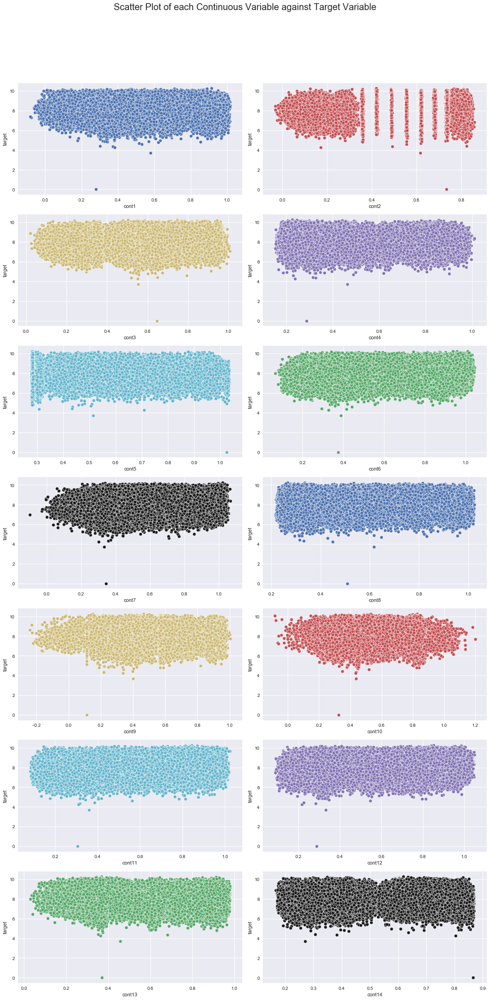

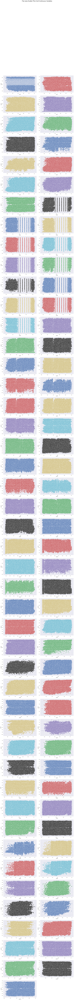

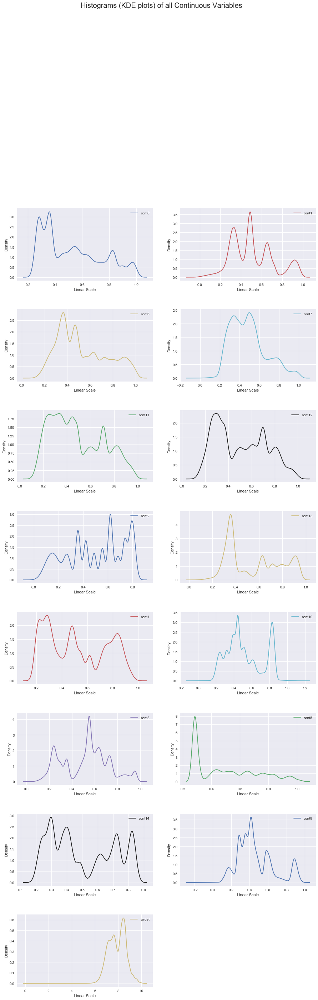

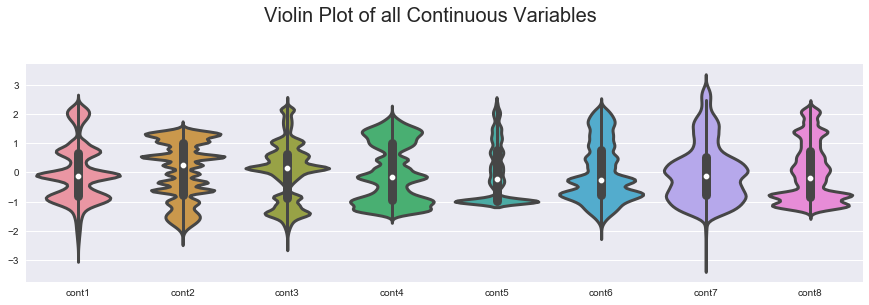

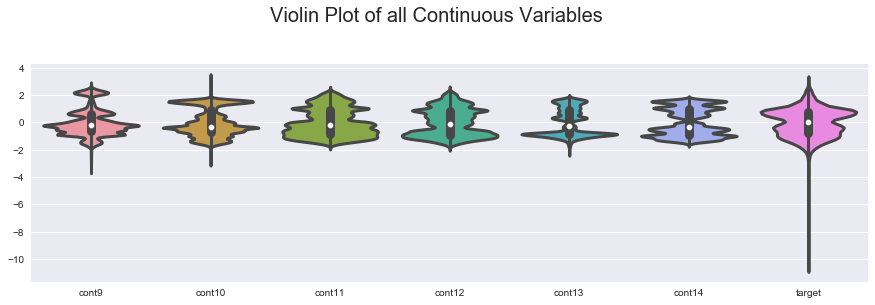

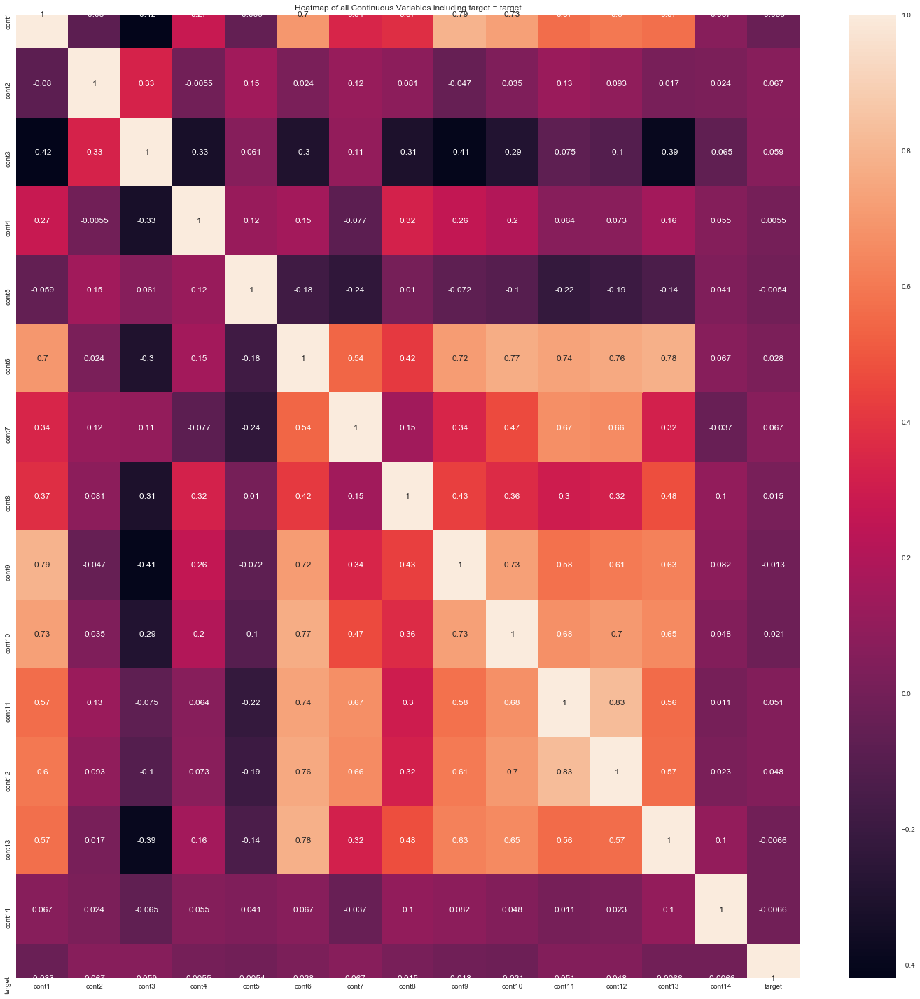

In [5]:

from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()
dftc = AV.AutoViz(
    filename='', 
    sep='' , 
    depVar='target', 
    dfte=df_train, 
    header=0, 
    verbose=2, 
    lowess=False, 
    chart_format='png', 
    max_rows_analyzed=300000, 
    max_cols_analyzed=30
)


In [6]:
%%time
display(dftc)

,cont1,cont2,cont3,cont4,cont5,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,cont14,target
112692,0.504176,0.617909,0.552098,0.432899,0.534159,0.378430,0.383229,0.678325,0.414715,0.425265,0.280041,0.368600,0.366569,0.246037,8.016285
19498,0.490267,0.357820,0.741811,0.298012,0.281703,0.738986,0.798888,0.345842,0.576756,0.695726,0.801773,0.833853,0.791183,0.586543,8.142400
31689,0.288753,0.486343,0.652569,0.325658,0.780088,0.260105,0.204861,0.295893,0.268857,0.327888,0.274302,0.212659,0.370709,0.826232,8.378037
231780,0.500519,0.359422,0.610752,0.358214,0.284217,0.371706,0.356771,0.399830,0.410804,0.400238,0.352212,0.302232,0.345183,0.808888,7.470451
4298,0.669743,0.555217,0.635977,0.286077,0.765437,0.643766,0.402815,0.358523,0.630701,0.813078,0.445577,0.606426,0.705765,0.378403,8.585406
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211543,0.467581,0.782336,0.553483,0.467705,0.950829,0.373790,0.417917,0.587471,0.397947,0.499212,0.363963,0.356367,0.311816,0.211885,9.052489
86293,0.473092,0.355660,0.503383,0.844502,0.496941,0.331064,0.301424,0.268663,0.358477,0.329081,0.313318,0.342643,0.337418,0.407145,8.943505
122579,0.306214,0.286297,0.626532,0.875011,0.830368,0.272267,0.352705,0.269673,0.348704,0.239891,0.184595,0.191891,0.360886,0.309898,8.115871
152315,0.246436,0.355326,0.544395,0.770125,0.749492,0.204789,0.344587,0.778089,0.142148,0.254407,0.169567,0.246516,0.330725,0.313152,8.445578


Wall time: 19 ms


In [7]:
print('We are done. That is all, folks!')
finish_time = dt.datetime.now()
print("Finished at ", finish_time)
elapsed = finish_time - start_time
print("Elapsed time: ", elapsed)

We are done. That is all, folks!
Finished at  2021-01-11 23:37:25.223663
Elapsed time:  0:06:51.209743
